# Data Preprocessing (5%): Describe the methods and steps used to preprocess and prepare the data.

1. Import Libraries


In [1]:
import torch
from diffusers.models import MotionAdapter
from diffusers import AnimateDiffSDXLPipeline, DDIMScheduler
from diffusers.utils import export_to_gif

In [2]:
print(torch.cuda.is_available())

False


In [3]:
device = (
    "mps"
    if torch.backends.mps.is_available()
    else "cuda"
    if torch.cuda.is_available()
    else "cpu"
)

## Loading Data: Show how to load the data
2. Load the Motion Adapter
The motion adapter is a pre-trained component that adds motion dynamics to the static images generated by the model. Loading it with the correct data type ensures that it operates efficiently on your hardware.

In [4]:


adapter = MotionAdapter.from_pretrained("guoyww/animatediff-motion-adapter-sdxl-beta", torch_dtype=torch.float16)




3. Load the Finetuned Model
The main model, Realistic_Vision_V5.1_noVAE, is loaded to generate the base images. This model is finetuned on the dataset for realistic image generation.

We use the AnimateDiffPipeline with a motion adapter for generating realistic animations. The pipeline integrates a pre-trained model (`SG161222/Realistic_Vision_V5.1_noVAE`) and the motion adapter (`guoyww/animatediff-motion-adapter-v1-5-2`).


In [5]:
# load SD 1.5 based finetuned model
#model_id = "SG161222/Realistic_Vision_V5.1_noVAE"
model_id = "stabilityai/stable-diffusion-xl-base-1.0"

In [6]:
scheduler = DDIMScheduler.from_pretrained(
    model_id,
    subfolder="scheduler",
    clip_sample=False,
    timestep_spacing="linspace",
    beta_schedule="linear",
    steps_offset=1,
)

The data is sourced from [guoyww/animatediff-motion-adapter-v1-5-2](https://huggingface.co/guoyww/animatediff-motion-adapter-v1-5-2) and [SG161222/Realistic_Vision_V5.1_noVAE](https://huggingface.co/SG161222/Realistic_Vision_V5.1_noVAE).


## Preprocessing Steps: Detail any preprocessing steps such as normalization, resizing, or augmentation.

In [7]:

from torchvision import transforms

preprocess = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5])
])


## Methods

We use a DDIM (Denoising Diffusion Implicit Models) scheduler for efficient sampling. The `AnimateDiffPipeline` leverages motion adapters to incorporate temporal dynamics into the generative process.


DDIM is chosen for its efficiency and high-quality sample generation capabilities. The motion adapter is crucial for creating coherent animations.



## 

In [8]:
scheduler = DDIMScheduler.from_pretrained(
    model_id,
    subfolder="scheduler",
    clip_sample=False,
    timestep_spacing="linspace",
    beta_schedule="linear",
    steps_offset=1,
)
# pipe.scheduler = scheduler



In [13]:

pipe = AnimateDiffSDXLPipeline.from_pretrained(
    model_id,
    motion_adapter=adapter,
    scheduler=scheduler,
    torch_dtype=torch.float16,
    variant="fp16",
) #.to(device)



Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

The config attributes {'center_input_sample': False, 'flip_sin_to_cos': True, 'freq_shift': 0, 'mid_block_type': 'UNetMidBlock2DCrossAttn', 'only_cross_attention': False, 'attention_head_dim': [5, 10, 20], 'dual_cross_attention': False, 'class_embed_type': None, 'num_class_embeds': None, 'upcast_attention': None, 'resnet_time_scale_shift': 'default', 'resnet_skip_time_act': False, 'resnet_out_scale_factor': 1.0, 'time_embedding_type': 'positional', 'time_embedding_dim': None, 'time_embedding_act_fn': None, 'timestep_post_act': None, 'conv_in_kernel': 3, 'conv_out_kernel': 3, 'class_embeddings_concat': False, 'mid_block_only_cross_attention': None, 'cross_attention_norm': None, 'addition_embed_type_num_heads': 64} were passed to UNetMotionModel, but are not expected and will be ignored. Please verify your config.json configuration file.


## Output

In [14]:
torch.mps.empty_cache()

In [ ]:
# enable memory savings
pipe.enable_vae_slicing()
pipe.enable_vae_tiling()

output = pipe(
    prompt="a purple sunset in the ocean reflection, realistic, high quality",
    negative_prompt="low quality, worst quality",
    num_inference_steps=20,
    guidance_scale=8,
    width=1024,
    height=1024,
    num_frames=16,
)

frames = output.frames[0]
export_to_gif(frames, "animation.gif")

  0%|          | 0/20 [00:00<?, ?it/s]

The generated animation is saved as `animation.gif`. Below is a sample frame from the animation:
![Sample Frame](animation.gif)


## Performance metric

Metrics such as frame coherence, visual quality, and temporal consistency are used to evaluate the animations.


# A new Model using HunggingFace

## Model Architecture
The model uses a Stable Diffusion-based pipeline with a motion adapter for generating animated sequences. The key components include:
- **Motion Adapter**: Adapts the model to handle motion data.
- **AnimateDiffPipeline**: Generates animated frames based on the input prompts.
- **DDIMScheduler**: Manages the diffusion process.

## Implementation
The following code initializes and configures the model components.

### Code
```python
# Initialize the motion adapter
adapter = MotionAdapter.from_pretrained("guoyww/animatediff-motion-adapter-v1-5-2", torch_dtype=torch.float16)

# Initialize the animation pipeline
pipe = AnimateDiffPipeline.from_pretrained("frankjoshua/toonyou_beta6", motion_adapter=adapter, torch_dtype=torch.float16)

# Configure the scheduler
pipe.scheduler = DDIMScheduler(beta_schedule="linear", steps_offset=1, clip_sample=False)

# Enable memory optimizations
pipe.enable_vae_slicing()
pipe.enable_model_cpu_offload()

In [3]:
import torch
from diffusers import MotionAdapter, AnimateDiffPipeline, DDIMScheduler
from diffusers.utils import export_to_gif

adapter = MotionAdapter.from_pretrained("guoyww/animatediff-motion-adapter-v1-5-2")
pipe = AnimateDiffPipeline.from_pretrained("frankjoshua/toonyou_beta6", motion_adapter=adapter)
pipe.scheduler = DDIMScheduler(beta_schedule="linear", steps_offset=1, clip_sample=False)
#output = pipe(prompt="A corgi walking in the park")
#frames = output.frames[0]
#export_to_gif(frames, "animation.gif")

The config attributes {'motion_activation_fn': 'geglu', 'motion_attention_bias': False, 'motion_cross_attention_dim': None} were passed to MotionAdapter, but are not expected and will be ignored. Please verify your config.json configuration file.
text_encoder/model.safetensors not found


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

/opt/homebrew/anaconda3/lib/python3.8/site-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(
The config attributes {'center_input_sample': False, 'flip_sin_to_cos': True, 'freq_shift': 0, 'mid_block_type': 'UNetMidBlock2DCrossAttn', 'only_cross_attention': False, 'attention_head_dim': 8, 'dual_cross_attention': False, 'class_embed_type': None, 'num_class_embeds': None, 'upcast_attention': False, 'resnet_time_scale_shift': 'default', 'resnet_skip_time_act': False, 'resnet_out_scale_factor': 1.0, 'time_embedding_type': 'positional', 'time_embedding_dim': None, 'time_embedding_act_fn': None, 'timestep_post_act': None, 'conv_in_kernel': 3, 'conv_out_kernel': 3, 'class_embeddings_concat': False, 'mid_block_only_cross_attention': None, 'cross_attention_norm': None, 'addition_embed_type_num_heads': 64} were passed 

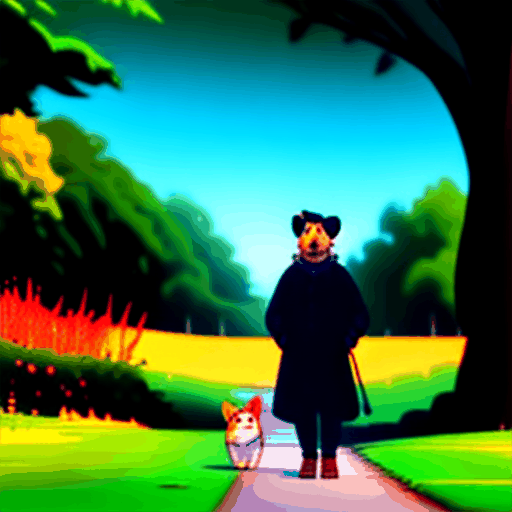

In [3]:
from IPython.display import Image
Image(filename="animation.gif")


### 3. Methods (5%)

# Methods

## Introduction
In this section, we explain the algorithms, techniques, and frameworks used in our project.

## Algorithms and Techniques
1. **Diffusion Models**: Used for generating high-quality images by gradually denoising a random input.
2. **Motion Adapter**: Enhances the diffusion model to handle temporal data for generating animated sequences.

## Frameworks
- **PyTorch**: Used for building and training the deep learning models.
- **Hugging Face Diffusers**: Provides pre-trained models and pipelines for diffusion-based generation.

### Code
The code snippets provided in the Model Implementation section demonstrate the use of these methods and frameworks.


# 2nd Result GIF restoration

In [43]:
output = pipe(prompt="Waves merging with a cascading waterfall in a forest at night, ethereal, high-quality, detailed, seamless loop", 
              negative_prompt="low quality, worst quality",
             num_inference_steps=50,
              guidance_scale=13
             )
frames = output.frames[0]
export_to_gif(frames, "animation2.gif")



  0%|          | 0/50 [00:00<?, ?it/s]

'animation2.gif'

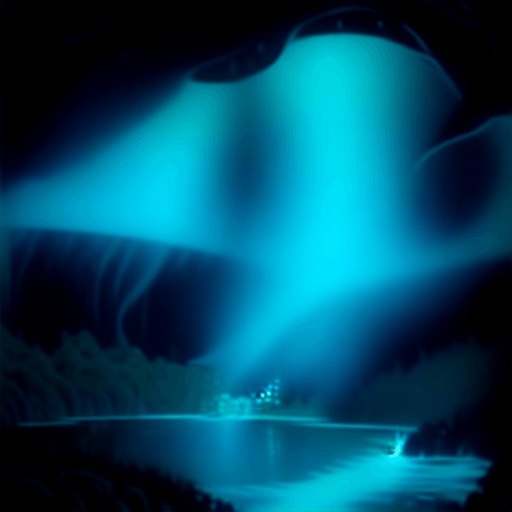

In [44]:
from IPython.display import Image
Image(filename="animation2.gif")

In [41]:
output = pipe(prompt="Waves merging with a cascading waterfall in a forest at night, ethereal, high-quality, detailed, seamless loop", 
              negative_prompt="low quality, worst quality",
             num_inference_steps=50,
              guidance_scale=11
             )
frames = output.frames[0]
export_to_gif(frames, "animation3.gif")

  0%|          | 0/50 [00:00<?, ?it/s]

'animation3.gif'

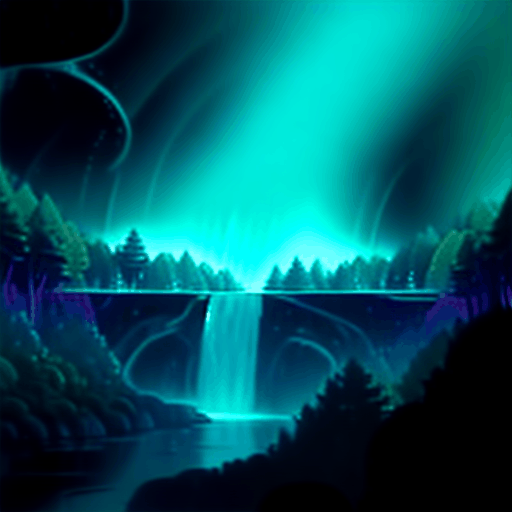

In [42]:
from IPython.display import Image
Image(filename="animation3.gif")

# Experiments and Results (10%)

# Experiments and Results

## Introduction
In this section, we present the experiments conducted and the results obtained. We use performance metrics, visualizations, and analyses to evaluate the model.

## Experiment Setup
We experiment with different numbers of inference steps to see the effect on the generated animations.

## Results
The following code generates animations with varying inference steps and saves them as GIFs.

### Code
```python
import torch
from diffusers import MotionAdapter, AnimateDiffPipeline, DDIMScheduler
from diffusers.utils import export_to_gif

adapter = MotionAdapter.from_pretrained("guoyww/animatediff-motion-adapter-v1-5-2", torch_dtype=torch.float16)
pipe = AnimateDiffPipeline.from_pretrained("frankjoshua/toonyou_beta6", motion_adapter=adapter, torch_dtype=torch.float16).to("cuda")
pipe.scheduler = DDIMScheduler(beta_schedule="linear", steps_offset=1, clip_sample=False)

# enable memory savings
pipe.enable_vae_slicing()
pipe.enable_model_cpu_offload()

num_steps_list = [10, 20, 30]  # Different inference steps for experimentation

for num_steps in num_steps_list:
    output = pipe(
        prompt="A sunrise as waves in a waterfall, ethereal, high quality, detailed",
        negative_prompt="low quality, worst quality",
        num_inference_steps=num_steps
    )
    frames = output.frames[0]
    export_to_gif(frames, f"animation_{num_steps}_steps.gif")
    print(f"Generated animation with {num_steps} inference steps.")


# The Picture Comparrison Experiment

In [6]:
from IPython.display import Image
num_steps_list = [10, 20, 30, 40, 50]

for num_steps in num_steps_list:
    print(f"Generating animation with {num_steps} inference steps")
    
    output = pipe(
        prompt="A sunrise casting golden light on waves merging with a cascading waterfall in a forest, serene atmosphere, ethereal, high-quality, detailed",
        negative_prompt="low quality, worst quality",
        num_inference_steps=num_steps
    )
    
    frames = output.frames[0]
    gif_filename = f"animation_{num_steps}_steps.gif"
    export_to_gif(frames, gif_filename)
    print(f"Saved animation to {gif_filename}")
    Image(filename=gif_filename)

print("Experimentation completed.")

Generating animation with 10 inference steps


  0%|          | 0/10 [00:00<?, ?it/s]

Saved animation to animation_10_steps.gif
Generating animation with 20 inference steps


  0%|          | 0/20 [00:00<?, ?it/s]

Saved animation to animation_20_steps.gif
Generating animation with 30 inference steps


  0%|          | 0/30 [00:00<?, ?it/s]

Saved animation to animation_30_steps.gif
Generating animation with 40 inference steps


  0%|          | 0/40 [00:00<?, ?it/s]

Saved animation to animation_40_steps.gif
Experimentation completed.


# Comments

The more num_inference_steps , the more better tuned the GIF will be.

In [8]:
from IPython.display import Image
num_steps_list = [10, 20, 30, 40, 50]

for num_steps in num_steps_list:
    print(f"Generating animation with {num_steps} inference steps")
    
    output = pipe(
        prompt="A sunrise reflecting golden light on waves merging with a cascading waterfall in a forest, serene atmosphere, ethereal, high-quality, detailed",
        negative_prompt="low quality, worst quality",
        num_inference_steps=num_steps
    )
    
    frames = output.frames[0]
    gif_filename = f"animation_{num_steps}_steps.gif"
    export_to_gif(frames, gif_filename)
    print(f"Saved animation to {gif_filename}")
    Image(filename=gif_filename)

print("Experimentation completed.")

Generating animation with 10 inference steps


  0%|          | 0/10 [00:00<?, ?it/s]

Saved animation to animation_10_steps.gif
Generating animation with 20 inference steps


  0%|          | 0/20 [00:00<?, ?it/s]

Saved animation to animation_20_steps.gif
Generating animation with 30 inference steps


  0%|          | 0/30 [00:00<?, ?it/s]

Saved animation to animation_30_steps.gif
Generating animation with 40 inference steps


  0%|          | 0/40 [00:00<?, ?it/s]

Saved animation to animation_40_steps.gif
Generating animation with 50 inference steps


  0%|          | 0/50 [00:00<?, ?it/s]

Saved animation to animation_50_steps.gif
Experimentation completed.


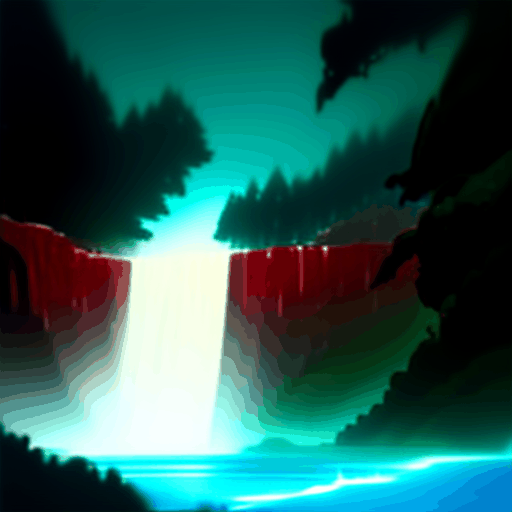

In [34]:
from IPython.display import Image
Image(filename='animation_10_steps.gif')

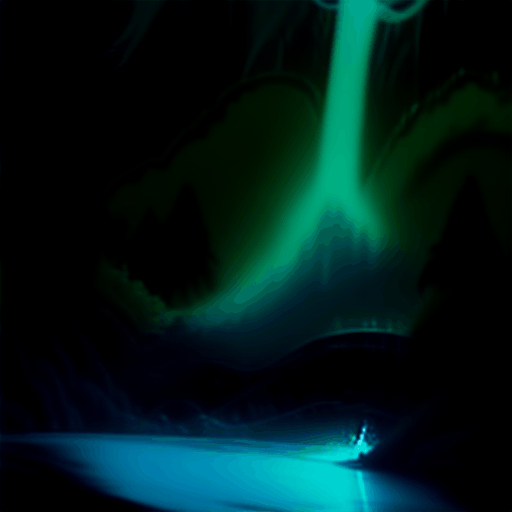

In [35]:
from IPython.display import Image
Image(filename='animation_20_steps.gif')

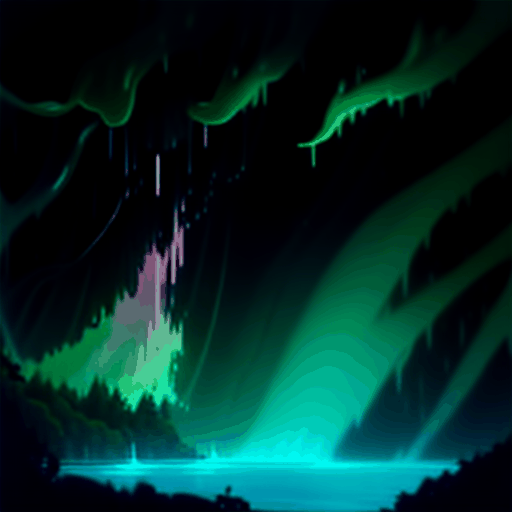

In [36]:
from IPython.display import Image
Image(filename='animation_30_steps.gif')

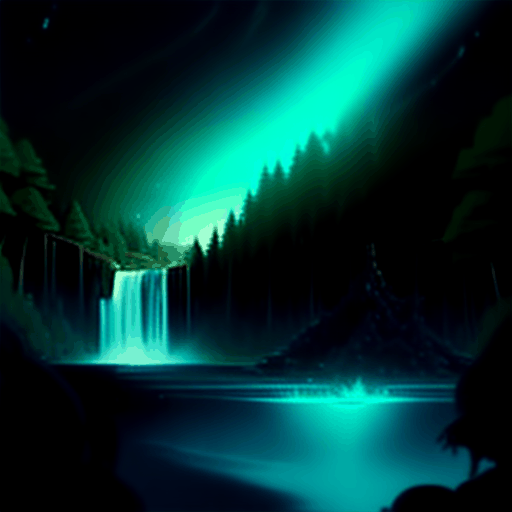

In [37]:
from IPython.display import Image
Image(filename='animation_40_steps.gif')

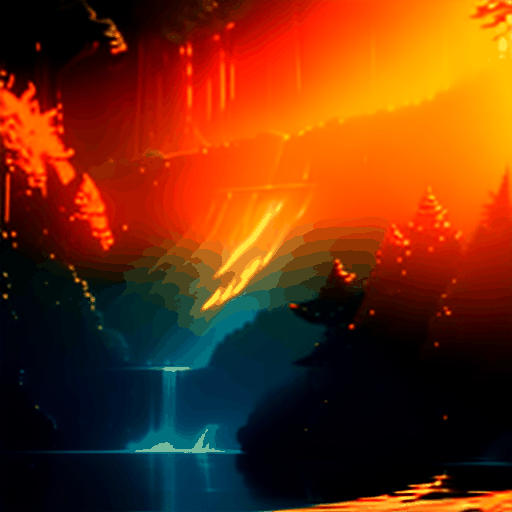

In [38]:
from IPython.display import Image
Image(filename='animation_50_steps.gif')

# Comments

The more the steps, the more detailed the pictures become. Increasing the number of steps increases the quality, coherence, and overall appearance of the generated animations. Better coherence, and animation styles as it flows downward. There does seem a diminish in the quality of animation as the waterfall is not flowing correctly.

In [14]:
generate_animation(prompt, negative_prompt, model_id, adapter_id, output_path)

The config attributes {'motion_activation_fn': 'geglu', 'motion_attention_bias': False, 'motion_cross_attention_dim': None} were passed to MotionAdapter, but are not expected and will be ignored. Please verify your config.json configuration file.
ERROR:__main__:An error occurred: Torch not compiled with CUDA enabled


In [6]:
from IPython.display import Image
num_steps_list = [5, 8, 12, 15]

for guide in num_steps_list:
    print(f"Generating animation with {guide} guidance_scale")
    
    output = pipe(
        prompt="A sunrise on waves merging with a cascading waterfall in a forest, serene atmosphere, ethereal, high-quality, detailed",
        negative_prompt="low quality, worst quality",
        num_inference_steps= 10,
        guidance_scale = guide
    )
    
    frames = output.frames[0]
    gif_filename = f"animation_{guide}_steps.gif"
    export_to_gif(frames, gif_filename)
    print(f"Saved animation to {gif_filename}")
    Image(filename=gif_filename)

print("Experimentation completed.")

Generating animation with 5 guidance_scale


  0%|          | 0/10 [00:00<?, ?it/s]

Saved animation to animation_5_steps.gif
Generating animation with 8 guidance_scale


  0%|          | 0/10 [00:00<?, ?it/s]

Saved animation to animation_8_steps.gif
Generating animation with 12 guidance_scale


  0%|          | 0/10 [00:00<?, ?it/s]

Saved animation to animation_12_steps.gif
Generating animation with 15 guidance_scale


  0%|          | 0/10 [00:00<?, ?it/s]

Saved animation to animation_15_steps.gif
Experimentation completed.


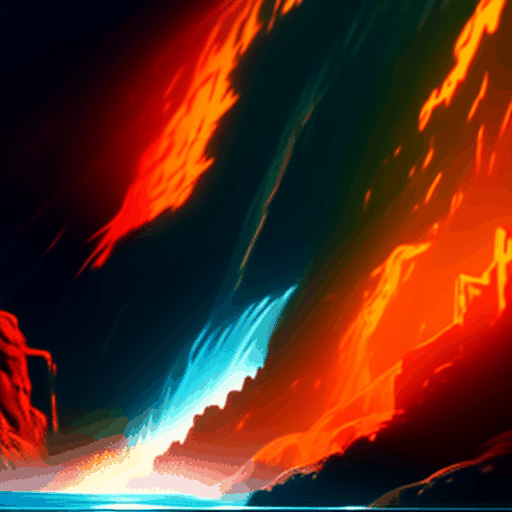

In [29]:
from IPython.display import Image
Image(filename='animation_5_steps.gif')

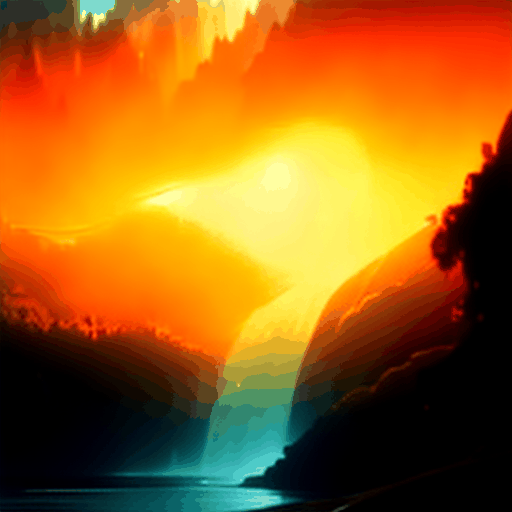

In [30]:
Image(filename='animation_8_steps.gif')

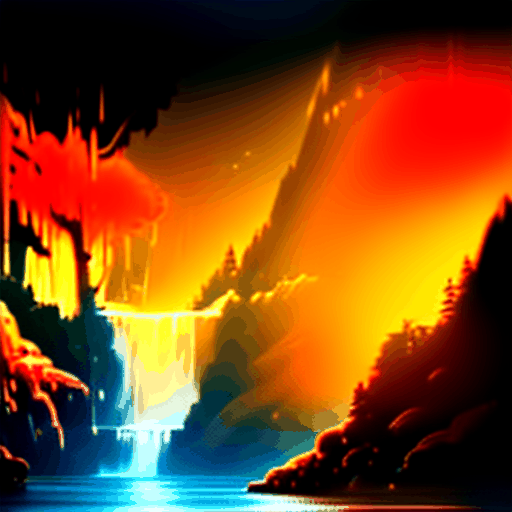

In [31]:
Image(filename='animation_12_steps.gif')

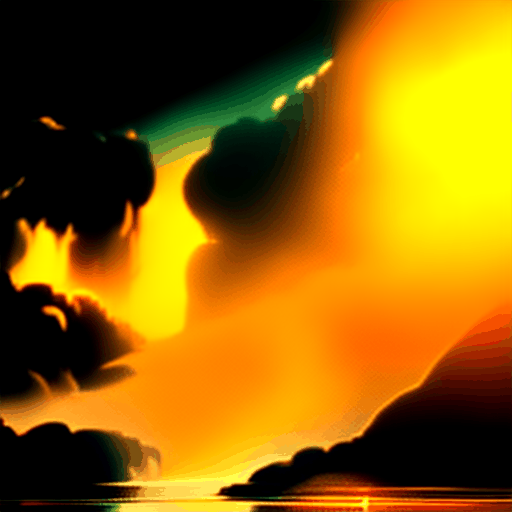

In [32]:
Image(filename='animation_15_steps.gif')

# Comments

The more guidance scale, the more closely fine-tuned the model becomes to the prompt. Looks like 15 overdoes the fine-tuning, as it will overfit the image.

Based on the images 12 seems to look the best, the extra light seems to be the prompt error. So wil need to fine-tune it.

There is also increased Visual Fidelity in the image leading to more items in the picture.

Balancing Creativity and Specificity is important as the good number is around 8 and 12 which gives a good image.

# Calcule the Performance Metric:


In [19]:
import torch
import numpy as np
from scipy.linalg import sqrtm
from diffusers import MotionAdapter, AnimateDiffPipeline, DDIMScheduler
from diffusers.utils import export_to_gif
from sklearn.metrics import pairwise_distances
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input
from tensorflow.keras.preprocessing import image
from skimage.metrics import structural_similarity as ssim
from PIL import Image as PILImage
import matplotlib.pyplot as plt

import torch
from diffusers import MotionAdapter, AnimateDiffPipeline, DDIMScheduler
from diffusers.utils import export_to_gif
from IPython.display import Image, display
import numpy as np
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr
import torchvision.transforms as transforms
from torchvision.models import vgg16
import torch.nn.functional as F



# Load InceptionV3 model for IS and FID calculations
inception_model = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))

# Helper function to preprocess image
def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(299, 299))
    img = image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = preprocess_input(img)
    return img

# Function to calculate Inception Score
def calculate_inception_score(images, model, splits=10):
    preds = model.predict(images)
    scores = []
    for i in range(splits):
        part = preds[i * (len(preds) // splits): (i + 1) * (len(preds) // splits)]
        kl = part * (np.log(part) - np.log(np.expand_dims(np.mean(part, 0), 0)))
        kl = np.mean(np.sum(kl, 1))
        scores.append(np.exp(kl))
    return np.mean(scores), np.std(scores)

# Function to calculate FID
def calculate_fid(real_images, generated_images, model):
    act1 = model.predict(real_images)
    act2 = model.predict(generated_images)
    mu1, sigma1 = np.mean(act1, axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = np.mean(act2, axis=0), np.cov(act2, rowvar=False)
    ssdiff = np.sum((mu1 - mu2)**2.0)
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

# Function to calculate SSIM
def calculate_ssim(img1, img2):
    img1 = np.array(PILImage.open(img1).convert('L'))
    img2 = np.array(PILImage.open(img2).convert('L'))
    return ssim(img1, img2)

import numpy as np
import cv2

def calculate_psnr(real_image, generated_image):
    mse = np.mean((real_image - generated_image) ** 2)
    if mse == 0:
        return float('inf')
    max_pixel = 255.0
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

class VGG16PerceptualLoss(torch.nn.Module):
    def __init__(self):
        super(VGG16PerceptualLoss, self).__init__()
        vgg = vgg16(pretrained=True).features
        self.layers = vgg[:16].eval()
        for param in self.layers.parameters():
            param.requires_grad = False
    
    def forward(self, input, target):
        input_features = self.layers(input)
        target_features = self.layers(target)
        return F.l1_loss(input_features, target_features)

# Function to compute SSIM
def compute_ssim(image1, image2):
    return ssim(image1, image2, multichannel=True)

# Function to compute PSNR
def compute_psnr(image1, image2):
    return psnr(image1, image2)

# Function to compute perceptual loss
def compute_perceptual_loss(image1, image2):
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Resize((224, 224)),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])
    vgg_loss = VGG16PerceptualLoss()
    img1 = transform(image1).unsqueeze(0)
    img2 = transform(image2).unsqueeze(0)
    return vgg_loss(img1, img2).item()





In [28]:
# Example usage
num_steps_list = [10, 20, 30, 40]



# Placeholder for quality metrics
ssim_scores = []
psnr_scores = []
perceptual_loss_scores = []

results = []

for num_steps in num_steps_list:
    print(f"Generating animation with {num_steps} steps")
    
    output = pipe(
        prompt="Waves merging with a cascading waterfall in a forest at night, ethereal, high-quality, detailed, seamless loop",
        negative_prompt="low quality, worst quality",
        num_inference_steps=num_steps,
        guidance_scale=7.5
    )
    
    frames = output.frames[0]
    gif_filename = f"animation_{num_steps}_steps.gif"
    export_to_gif(frames, gif_filename)
    print(f"Saved animation to {gif_filename}")
    
    generated_images = preprocess_image(gif_filename)
    
    # Calculate Inception Score
    inception_score, std = calculate_inception_score((generated_images), inception_model)
    print(f"Inception Score for {num_steps} steps: {inception_score} ± {std}")

    ssim_scores = []
    psnr_scores = []
    
    
    
    

print("Experimentation completed.")

Generating animation with 10 steps


  0%|          | 0/10 [00:00<?, ?it/s]

Saved animation to animation_10_steps.gif
1/1 [==============================] - 0s 228ms/step
Inception Score for 10 steps: nan ± nan
Generating animation with 20 steps


  0%|          | 0/20 [00:00<?, ?it/s]

Saved animation to animation_20_steps.gif
1/1 [==============================] - 0s 252ms/step
Inception Score for 20 steps: nan ± nan
Generating animation with 30 steps


  0%|          | 0/30 [00:00<?, ?it/s]

Saved animation to animation_30_steps.gif
1/1 [==============================] - 0s 294ms/step
Inception Score for 30 steps: nan ± nan
Generating animation with 40 steps


  0%|          | 0/40 [00:00<?, ?it/s]

Saved animation to animation_40_steps.gif
1/1 [==============================] - 0s 368ms/step
Inception Score for 40 steps: nan ± nan
Experimentation completed.


In [18]:
generated_images =  preprocess_image(gif_filename)
#generated_images

animation_10_steps.gif


In [46]:
from IPython.display import Image
num_steps_list = [5, 8, 12, 15]

for guide in num_steps_list:
    print(f"Generating animation with {guide} guidance_scale")
    
    output = pipe(
        prompt="Waves merging with a cascading waterfall in a forest at night, ethereal, high-quality, detailed, seamless loop",
        negative_prompt="low quality, worst quality",
        num_inference_steps= 50,
        guidance_scale = guide
    )
    
    frames = output.frames[0]
    gif_filename = f"animation_{guide}_steps.gif"
    export_to_gif(frames, gif_filename)
    print(f"Saved animation to {gif_filename}")
    Image(filename=gif_filename)

print("Experimentation completed.")

Generating animation with 5 guidance_scale


  0%|          | 0/50 [00:00<?, ?it/s]

Saved animation to animation_5_steps.gif
Generating animation with 8 guidance_scale


  0%|          | 0/50 [00:00<?, ?it/s]

Saved animation to animation_8_steps.gif
Generating animation with 12 guidance_scale


  0%|          | 0/50 [00:00<?, ?it/s]

Saved animation to animation_12_steps.gif
Generating animation with 15 guidance_scale


  0%|          | 0/50 [00:00<?, ?it/s]

Saved animation to animation_15_steps.gif
Experimentation completed.


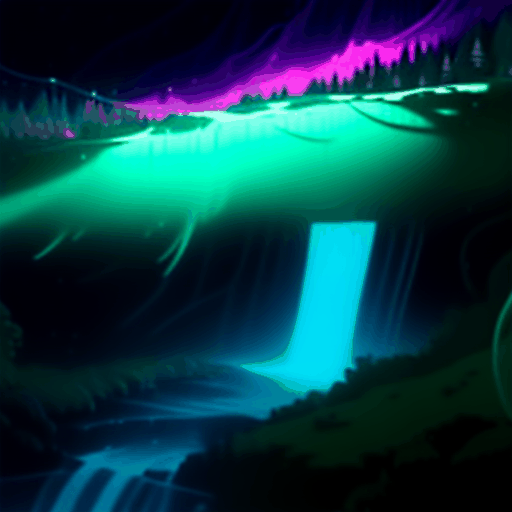

In [49]:
from IPython.display import Image
Image(filename='animation_5_steps.gif')

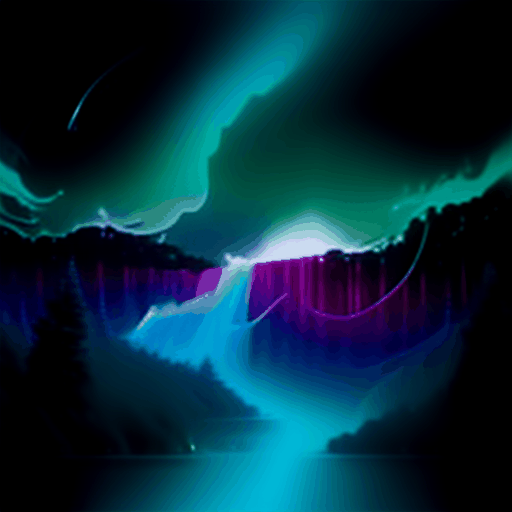

In [50]:
from IPython.display import Image
Image(filename='animation_8_steps.gif')

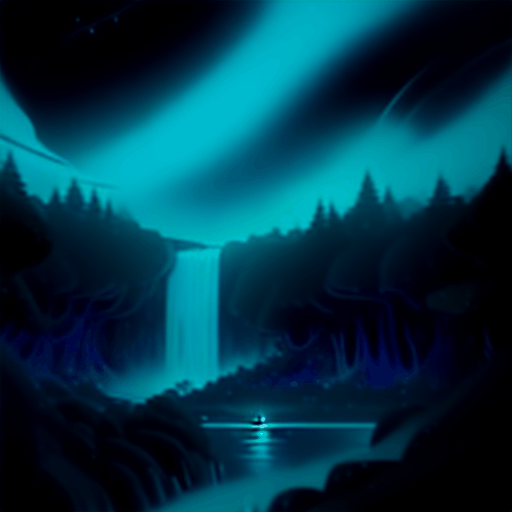

In [51]:
from IPython.display import Image
Image(filename='animation_12_steps.gif')

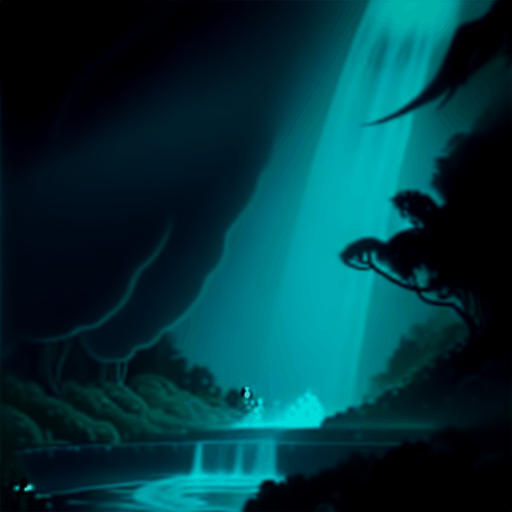

In [52]:
from IPython.display import Image
Image(filename='animation_15_steps.gif')

# A New Model

## MotionAdapter

Purpose: MotionAdapter is likely a specialized component or module designed to handle motion-related features in animations or videos. It adapts or processes motion data to be compatible with the animation pipeline.

from_pretrained Method: This method loads a pre-trained MotionAdapter model from a specified repository or source. In this case, it is loading the model from guoyww/animatediff-motion-adapter-v1-5-2.

Usage: By using a pre-trained model, you benefit from pre-learned weights and configurations that are likely fine-tuned for specific tasks related to motion adaptation, saving time and computational resources.

## AnimateDiffPipeline

Purpose: AnimateDiffPipeline is likely a pipeline class designed for generating animations or videos using diffusion models. It encapsulates the entire process, from input data to output animation.

from_pretrained Method: This method loads a pre-trained pipeline model from a specified repository or source. In this case, it is loading the model from SG161222/Realistic_Vision_V5.1_noVAE.

This new model tries to not use a VAE. The model might employ alternative architectures such as GANs (Generative Adversarial Networks).

motion_adapter Parameter: This parameter allows the integration of the previously loaded MotionAdapter into the pipeline, enabling the pipeline to utilize motion adaptation features.

In [71]:
import torch
from diffusers import MotionAdapter, AnimateDiffPipeline, DDIMScheduler
from diffusers.utils import export_to_gif

adapter = MotionAdapter.from_pretrained("guoyww/animatediff-motion-adapter-v1-5-2")
pipe = AnimateDiffPipeline.from_pretrained("SG161222/Realistic_Vision_V5.1_noVAE", motion_adapter=adapter)
pipe.scheduler = DDIMScheduler(beta_schedule="linear", steps_offset=1, clip_sample=False)
output = pipe(
        prompt=" A cascading waterfall in a forest at night, high-quality, detailed, seamless loop",
        negative_prompt="low quality, worst quality",
        num_inference_steps= 10,
        guidance_scale = 7.5
    )
frames = output.frames[0]
export_to_gif(frames, "animation3.gif")

The config attributes {'motion_activation_fn': 'geglu', 'motion_attention_bias': False, 'motion_cross_attention_dim': None} were passed to MotionAdapter, but are not expected and will be ignored. Please verify your config.json configuration file.


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

The config attributes {'center_input_sample': False, 'flip_sin_to_cos': True, 'freq_shift': 0, 'mid_block_type': 'UNetMidBlock2DCrossAttn', 'only_cross_attention': False, 'attention_head_dim': 8, 'dual_cross_attention': False, 'class_embed_type': None, 'num_class_embeds': None, 'upcast_attention': False, 'resnet_time_scale_shift': 'default', 'resnet_skip_time_act': False, 'resnet_out_scale_factor': 1.0, 'time_embedding_type': 'positional', 'time_embedding_dim': None, 'time_embedding_act_fn': None, 'timestep_post_act': None, 'conv_in_kernel': 3, 'conv_out_kernel': 3, 'class_embeddings_concat': False, 'mid_block_only_cross_attention': None, 'cross_attention_norm': None, 'addition_embed_type_num_heads': 64} were passed to UNetMotionModel, but are not expected and will be ignored. Please verify your config.json configuration file.


  0%|          | 0/2 [00:00<?, ?it/s]

'animation3.gif'

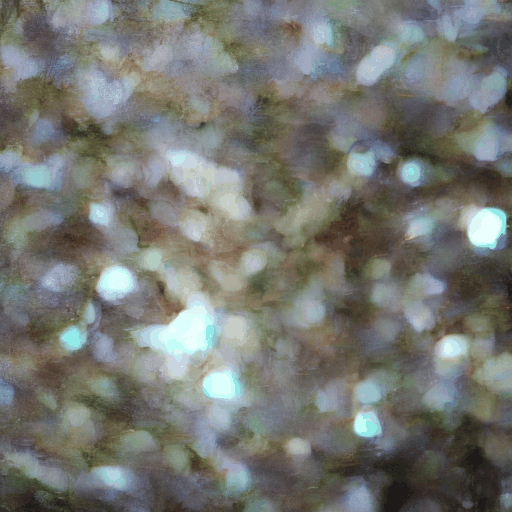

In [72]:
Image(filename='animation3.gif')

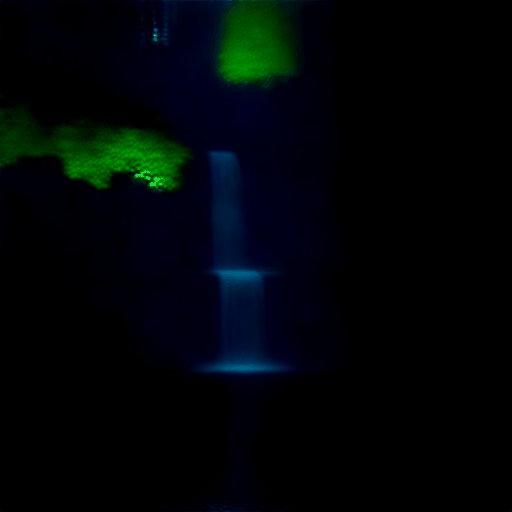

In [54]:
Image(filename='animation.gif')

# NeW Model text to Video

In [ ]:
import torch
from diffusers import TextToVideoZeroPipeline

model_id = "runwayml/stable-diffusion-v1-5"
pipe = TextToVideoZeroPipeline.from_pretrained(model_id) #.to("cuda")

prompt = "House on a rock"
result = pipe(prompt=prompt).images

export_to_video(result, "video.mp4")

#result = [(r * 255).astype("uint8") for r in result]


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/anaconda3/lib/python3.8/site-packages/torch/nn/functional.py:4343: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


  0%|          | 0/48 [00:00<?, ?it/s]

In [102]:
export_to_video(result, "video.mp4")

'video.mp4'

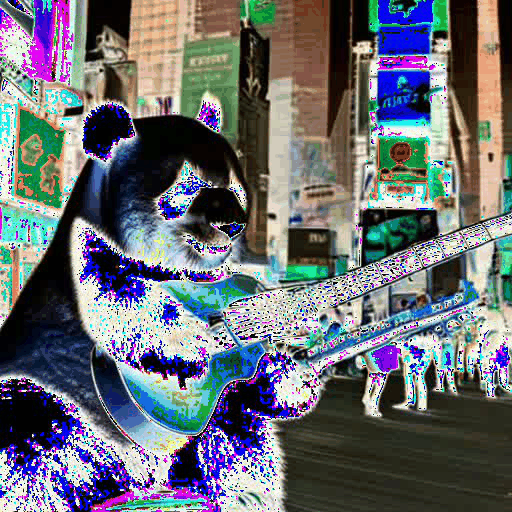

In [103]:
from PIL import Image
convert_mp4_to_jpgs("video.mp4")
make_gif("output", "video.gif")
from IPython.display import Image
Image(filename='video.gif')

# New Model

This model is  guoyww/animatediff-motion-adapter-v1-5-2

In [ ]:
import cv2


def convert_mp4_to_jpgs(path):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    else:
        # Clear the output folder if it already exists
        for filename in os.listdir(output_folder):
            file_path = os.path.join(output_folder, filename)
            try:
                if os.path.isfile(file_path) or os.path.islink(file_path):
                    os.unlink(file_path)
                elif os.path.isdir(file_path):
                    shutil.rmtree(file_path)
            except Exception as e:
                print(f"Failed to delete {file_path}. Reason: {e}")
    video_capture = cv2.VideoCapture(path)
    still_reading, image = video_capture.read()
    frame_count = 0
    while still_reading:
        cv2.imwrite(f"output/frame_{frame_count:03d}.jpg", image)
        
        # read next image
        still_reading, image = video_capture.read()
        frame_count += 1




import glob

from PIL import Image


def make_gif(frame_folder, name):
    images = glob.glob(f"{frame_folder}/*.jpg")
    images.sort()
    frames = [Image.open(image) for image in images]
    frame_one = frames[0]
    frame_one.save(name, format="GIF", append_images=frames,
                   save_all=True, duration=50, loop=0)
    



In [95]:
import torch
from diffusers import DiffusionPipeline
from diffusers.utils import export_to_video
from diffusers import MotionAdapter, AnimateDiffPipeline, DDIMScheduler
from diffusers.utils import export_to_gif

import torch
from diffusers import MotionAdapter, AnimateDiffPipeline, DDIMScheduler
from diffusers.utils import export_to_gif

adapter = MotionAdapter.from_pretrained("guoyww/animatediff-motion-adapter-v1-5-2")
pipe = DiffusionPipeline.from_pretrained("damo-vilab/text-to-video-ms-1.7b", ) # motion_adapter=adapter
# pipe = AnimateDiffPipeline.from_pretrained("SG161222/Realistic_Vision_V5.1_noVAE", motion_adapter=adapter)
# pipe.scheduler = DDIMScheduler(beta_schedule="linear", steps_offset=1, clip_sample=False)
output = pipe(
        prompt="Hyper-realistic photo of an abandoned industrial site during a storm",
        # negative_prompt="low quality, worst quality",
        # num_inference_steps= 100,
        # guidance_scale = 8
    )
frames = output.frames[0]
export_to_video(frames, "storm.mp4")

The config attributes {'motion_activation_fn': 'geglu', 'motion_attention_bias': False, 'motion_cross_attention_dim': None} were passed to MotionAdapter, but are not expected and will be ignored. Please verify your config.json configuration file.


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

'storm.mp4'

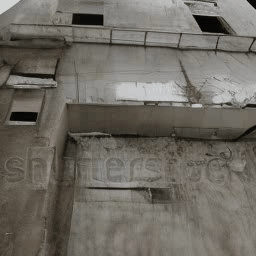

In [96]:
from PIL import Image
convert_mp4_to_jpgs("storm.mp4")
make_gif("output", "storm.gif")
from IPython.display import Image
Image(filename='storm.gif')

In [69]:
frames

array([[[[0.00162417, 0.06128684, 0.10531998],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.01552442, 0.        ]],

        [[0.        , 0.        , 0.00825047],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ]],

        [[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ]],

        ...,

        [[0.        , 0.        , 0.01634514],
         [0.        , 0.        , 0.        ]

In [58]:
!pip install moviepy

In [ ]:
import torch
from diffusers import DiffusionPipeline
from diffusers.utils import export_to_video

pipe = DiffusionPipeline.from_pretrained("damo-vilab/text-to-video-ms-1.7b", torch_dtype=torch.float16, variant="fp16")
pipe.enable_model_cpu_offload()

# memory optimization
pipe.enable_vae_slicing()

prompt = "Darth Vader surfing a wave"
video_frames = pipe(prompt, num_frames=64).frames[0]
video_path = export_to_video(video_frames)
video_path

In [75]:


video_path = export_to_video(frames, "waves2.mp4")
video_path

'waves2.mp4'

In [78]:
import cv2


def convert_mp4_to_jpgs(path):
    video_capture = cv2.VideoCapture(path)
    still_reading, image = video_capture.read()
    frame_count = 0
    while still_reading:
        cv2.imwrite(f"output/frame_{frame_count:03d}.jpg", image)
        
        # read next image
        still_reading, image = video_capture.read()
        frame_count += 1


convert_mp4_to_jpgs("waves2.mp4")

import glob

from PIL import Image


def make_gif(frame_folder, name):
    images = glob.glob(f"{frame_folder}/*.jpg")
    images.sort()
    frames = [Image.open(image) for image in images]
    frame_one = frames[0]
    frame_one.save(name, format="GIF", append_images=frames,
                   save_all=True, duration=50, loop=0)
    


make_gif("output", "waves.gif")


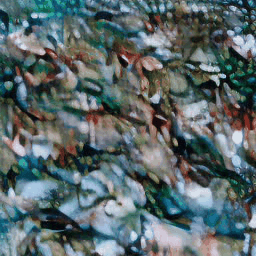

In [79]:
from IPython.display import Image
Image(filename='waves.gif')

In [7]:
from diffusers import StableDiffusionPipeline
import torch
from dataclasses import dataclass
from typing import Callable, List, Optional, Union
import numpy as np
from diffusers.utils import deprecate, logging, BaseOutput
from einops import rearrange, repeat
from torch.nn.functional import grid_sample
import torchvision.transforms as T
from transformers import CLIPFeatureExtractor, CLIPTextModel, CLIPTokenizer
from diffusers.models import AutoencoderKL, UNet2DConditionModel
from diffusers.schedulers import KarrasDiffusionSchedulers
from diffusers.pipelines.stable_diffusion import StableDiffusionSafetyChecker
import PIL
from PIL import Image
from kornia.morphology import dilation

In [8]:
# pip install kornia

In [9]:



@dataclass
class TextToVideoPipelineOutput(BaseOutput):
    # videos: Union[torch.Tensor, np.ndarray]
    # code: Union[torch.Tensor, np.ndarray]
    images: Union[List[PIL.Image.Image], np.ndarray]
    nsfw_content_detected: Optional[List[bool]]


def coords_grid(batch, ht, wd, device):
    # Adapted from https://github.com/princeton-vl/RAFT/blob/master/core/utils/utils.py
    coords = torch.meshgrid(torch.arange(
        ht, device=device), torch.arange(wd, device=device))
    coords = torch.stack(coords[::-1], dim=0).float()
    return coords[None].repeat(batch, 1, 1, 1)


class TextToVideoPipeline(StableDiffusionPipeline):
    def __init__(
        self,
        vae: AutoencoderKL,
        text_encoder: CLIPTextModel,
        tokenizer: CLIPTokenizer,
        unet: UNet2DConditionModel,
        scheduler: KarrasDiffusionSchedulers,
        safety_checker: StableDiffusionSafetyChecker,
        feature_extractor: CLIPFeatureExtractor,
        requires_safety_checker: bool = True,
    ):
        super().__init__(vae, text_encoder, tokenizer, unet, scheduler,
                         safety_checker, feature_extractor, requires_safety_checker)

    def DDPM_forward(self, x0, t0, tMax, generator, device, shape, text_embeddings):
        rand_device = "cpu" if device.type == "mps" else device

        if x0 is None:
            return torch.randn(shape, generator=generator, device=rand_device, dtype=text_embeddings.dtype).to(device)
        else:
            eps = torch.randn(x0.shape, dtype=text_embeddings.dtype, generator=generator,
                              device=rand_device)
            alpha_vec = torch.prod(self.scheduler.alphas[t0:tMax])

            xt = torch.sqrt(alpha_vec) * x0 + \
                torch.sqrt(1-alpha_vec) * eps
            return xt

    def prepare_latents(self, batch_size, num_channels_latents, video_length, height, width, dtype, device, generator, latents=None):
        shape = (batch_size, num_channels_latents, video_length, height //
                 self.vae_scale_factor, width // self.vae_scale_factor)
        if isinstance(generator, list) and len(generator) != batch_size:
            raise ValueError(
                f"You have passed a list of generators of length {len(generator)}, but requested an effective batch"
                f" size of {batch_size}. Make sure the batch size matches the length of the generators."
            )

        if latents is None:
            rand_device = "cpu" if device.type == "mps" else device

            if isinstance(generator, list):
                shape = (1,) + shape[1:]
                latents = [
                    torch.randn(
                        shape, generator=generator[i], device=rand_device, dtype=dtype)
                    for i in range(batch_size)
                ]
                latents = torch.cat(latents, dim=0).to(device)
            else:
                latents = torch.randn(
                    shape, generator=generator, device=rand_device, dtype=dtype).to(device)
        else:
            latents = latents.to(device)

        # scale the initial noise by the standard deviation required by the scheduler
        latents = latents * self.scheduler.init_noise_sigma
        return latents

    def warp_latents_independently(self, latents, reference_flow):
        _, _, H, W = reference_flow.size()
        b, _, f, h, w = latents.size()
        assert b == 1
        coords0 = coords_grid(f, H, W, device=latents.device).to(latents.dtype)

        coords_t0 = coords0 + reference_flow
        coords_t0[:, 0] /= W
        coords_t0[:, 1] /= H

        coords_t0 = coords_t0 * 2.0 - 1.0

        coords_t0 = T.Resize((h, w))(coords_t0)

        coords_t0 = rearrange(coords_t0, 'f c h w -> f h w c')

        latents_0 = rearrange(latents[0], 'c f h w -> f  c  h w')
        warped = grid_sample(latents_0, coords_t0,
                             mode='nearest', padding_mode='reflection')

        warped = rearrange(warped, '(b f) c h w -> b c f h w', f=f)
        return warped

    def DDIM_backward(self, num_inference_steps, timesteps, skip_t, t0, t1, do_classifier_free_guidance, null_embs, text_embeddings, latents_local,
                      latents_dtype, guidance_scale, guidance_stop_step, callback, callback_steps, extra_step_kwargs, num_warmup_steps):
        entered = False

        f = latents_local.shape[2]

        latents_local = rearrange(latents_local, "b c f w h -> (b f) c w h")

        latents = latents_local.detach().clone()
        x_t0_1 = None
        x_t1_1 = None

        with self.progress_bar(total=num_inference_steps) as progress_bar:
            for i, t in enumerate(timesteps):
                if t > skip_t:
                    continue
                else:
                    if not entered:
                        print(
                            f"Continue DDIM with i = {i}, t = {t}, latent = {latents.shape}, device = {latents.device}, type = {latents.dtype}")
                        entered = True

                latents = latents.detach()
                # expand the latents if we are doing classifier free guidance
                latent_model_input = torch.cat(
                    [latents] * 2) if do_classifier_free_guidance else latents
                latent_model_input = self.scheduler.scale_model_input(
                    latent_model_input, t)

                # predict the noise residual
                with torch.no_grad():
                    if null_embs is not None:
                        text_embeddings[0] = null_embs[i][0]
                    te = torch.cat([repeat(text_embeddings[0, :, :], "c k -> f c k", f=f),
                                   repeat(text_embeddings[1, :, :], "c k -> f c k", f=f)])
                    noise_pred = self.unet(
                        latent_model_input, t, encoder_hidden_states=te).sample.to(dtype=latents_dtype)

                # perform guidance
                if do_classifier_free_guidance:
                    noise_pred_uncond, noise_pred_text = noise_pred.chunk(
                        2)
                    noise_pred = noise_pred_uncond + guidance_scale * \
                        (noise_pred_text - noise_pred_uncond)

                if i >= guidance_stop_step * len(timesteps):
                    alpha = 0
                # compute the previous noisy sample x_t -> x_t-1
                latents = self.scheduler.step(
                    noise_pred, t, latents, **extra_step_kwargs).prev_sample
                # latents = latents - alpha * grads / (torch.norm(grads) + 1e-10)
                # call the callback, if provided

                if i < len(timesteps)-1 and timesteps[i+1] == t0:
                    x_t0_1 = latents.detach().clone()
                    print(f"latent t0 found at i = {i}, t = {t}")
                elif i < len(timesteps)-1 and timesteps[i+1] == t1:
                    x_t1_1 = latents.detach().clone()
                    print(f"latent t1 found at i={i}, t = {t}")

                if i == len(timesteps) - 1 or ((i + 1) > num_warmup_steps and (i + 1) % self.scheduler.order == 0):
                    progress_bar.update()
                    if callback is not None and i % callback_steps == 0:
                        callback(i, t, latents)

        latents = rearrange(latents, "(b f) c w h -> b c f  w h", f=f)

        res = {"x0": latents.detach().clone()}
        if x_t0_1 is not None:
            x_t0_1 = rearrange(x_t0_1, "(b f) c w h -> b c f  w h", f=f)
            res["x_t0_1"] = x_t0_1.detach().clone()
        if x_t1_1 is not None:
            x_t1_1 = rearrange(x_t1_1, "(b f) c w h -> b c f  w h", f=f)
            res["x_t1_1"] = x_t1_1.detach().clone()
        return res

    def decode_latents(self, latents):
        video_length = latents.shape[2]
        latents = 1 / 0.18215 * latents
        latents = rearrange(latents, "b c f h w -> (b f) c h w")
        video = self.vae.decode(latents).sample
        video = rearrange(video, "(b f) c h w -> b c f h w", f=video_length)
        video = (video / 2 + 0.5).clamp(0, 1)
        # we always cast to float32 as this does not cause significant overhead and is compatible with bfloa16
        video = video.detach().cpu()
        return video

    def create_motion_field(self, motion_field_strength_x, motion_field_strength_y, frame_ids, video_length, latents):

        reference_flow = torch.zeros(
            (video_length-1, 2, 512, 512), device=latents.device, dtype=latents.dtype)
        for fr_idx, frame_id in enumerate(frame_ids):
            reference_flow[fr_idx, 0, :,
                           :] = motion_field_strength_x*(frame_id)
            reference_flow[fr_idx, 1, :,
                           :] = motion_field_strength_y*(frame_id)
        return reference_flow

    def create_motion_field_and_warp_latents(self, motion_field_strength_x, motion_field_strength_y, frame_ids, video_length, latents):

        motion_field = self.create_motion_field(motion_field_strength_x=motion_field_strength_x,
                                                motion_field_strength_y=motion_field_strength_y, latents=latents, video_length=video_length, frame_ids=frame_ids)
        for idx, latent in enumerate(latents):
            latents[idx] = self.warp_latents_independently(
                latent[None], motion_field)
        return motion_field, latents

    @torch.no_grad()
    def __call__(
        self,
        prompt: Union[str, List[str]],
        video_length: Optional[int],
        height: Optional[int] = None,
        width: Optional[int] = None,
        num_inference_steps: int = 50,
        guidance_scale: float = 7.5,
        guidance_stop_step: float = 0.5,
        negative_prompt: Optional[Union[str, List[str]]] = None,
        num_videos_per_prompt: Optional[int] = 1,
        eta: float = 0.0,
        generator: Optional[Union[torch.Generator,
                                  List[torch.Generator]]] = None,
        xT: Optional[torch.FloatTensor] = None,
        null_embs: Optional[torch.FloatTensor] = None,
        motion_field_strength_x: float = 12,
        motion_field_strength_y: float = 12,
        output_type: Optional[str] = "tensor",
        return_dict: bool = True,
        callback: Optional[Callable[[
            int, int, torch.FloatTensor], None]] = None,
        callback_steps: Optional[int] = 1,
        use_motion_field: bool = True,
        smooth_bg: bool = False,
        smooth_bg_strength: float = 0.4,
        t0: int = 44,
        t1: int = 47,
        **kwargs,
    ):
        frame_ids = kwargs.pop("frame_ids", list(range(video_length)))
        assert t0 < t1
        assert num_videos_per_prompt == 1
        assert isinstance(prompt, list) and len(prompt) > 0
        assert isinstance(negative_prompt, list) or negative_prompt is None

        prompt_types = [prompt, negative_prompt]

        for idx, prompt_type in enumerate(prompt_types):
            prompt_template = None
            for prompt in prompt_type:
                if prompt_template is None:
                    prompt_template = prompt
                else:
                    assert prompt == prompt_template
            if prompt_types[idx] is not None:
                prompt_types[idx] = prompt_types[idx][0]
        prompt = prompt_types[0]
        negative_prompt = prompt_types[1]

        # Default height and width to unet
        height = height or self.unet.config.sample_size * self.vae_scale_factor
        width = width or self.unet.config.sample_size * self.vae_scale_factor

        # Check inputs. Raise error if not correct
        self.check_inputs(prompt, height, width, callback_steps)

        # Define call parameters
        batch_size = 1 if isinstance(prompt, str) else len(prompt)
        device = self._execution_device
        # here `guidance_scale` is defined analog to the guidance weight `w` of equation (2)
        # of the Imagen paper: https://arxiv.org/pdf/2205.11487.pdf . `guidance_scale = 1`
        # corresponds to doing no classifier free guidance.
        do_classifier_free_guidance = guidance_scale > 1.0

        # Encode input prompt
        text_embeddings = self._encode_prompt(
            prompt, device, num_videos_per_prompt, do_classifier_free_guidance, negative_prompt
        )

        # Prepare timesteps
        self.scheduler.set_timesteps(num_inference_steps, device=device)
        timesteps = self.scheduler.timesteps

        # print(f" Latent shape = {latents.shape}")

        # Prepare latent variables
        num_channels_latents = self.unet.in_channels

        xT = self.prepare_latents(
            batch_size * num_videos_per_prompt,
            num_channels_latents,
            1,
            height,
            width,
            text_embeddings.dtype,
            device,
            generator,
            xT,
        )
        dtype = xT.dtype

        # when motion field is not used, augment with random latent codes
        if use_motion_field:
            xT = xT[:, :, :1]
        else:
            if xT.shape[2] < video_length:
                xT_missing = self.prepare_latents(
                    batch_size * num_videos_per_prompt,
                    num_channels_latents,
                    video_length-xT.shape[2],
                    height,
                    width,
                    text_embeddings.dtype,
                    device,
                    generator,
                    None,
                )
                xT = torch.cat([xT, xT_missing], dim=2)

        xInit = xT.clone()

        timesteps_ddpm = [981, 961, 941, 921, 901, 881, 861, 841, 821, 801, 781, 761, 741, 721,
                          701, 681, 661, 641, 621, 601, 581, 561, 541, 521, 501, 481, 461, 441,
                          421, 401, 381, 361, 341, 321, 301, 281, 261, 241, 221, 201, 181, 161,
                          141, 121, 101,  81,  61,  41,  21,   1]
        timesteps_ddpm.reverse()

        t0 = timesteps_ddpm[t0]
        t1 = timesteps_ddpm[t1]

        print(f"t0 = {t0} t1 = {t1}")
        x_t1_1 = None

        # Prepare extra step kwargs.
        extra_step_kwargs = self.prepare_extra_step_kwargs(generator, eta)
        # Denoising loop
        num_warmup_steps = len(timesteps) - \
            num_inference_steps * self.scheduler.order

        shape = (batch_size, num_channels_latents, 1, height //
                 self.vae_scale_factor, width // self.vae_scale_factor)

        ddim_res = self.DDIM_backward(num_inference_steps=num_inference_steps, timesteps=timesteps, skip_t=1000, t0=t0, t1=t1, do_classifier_free_guidance=do_classifier_free_guidance,
                                      null_embs=null_embs, text_embeddings=text_embeddings, latents_local=xT, latents_dtype=dtype, guidance_scale=guidance_scale, guidance_stop_step=guidance_stop_step,
                                      callback=callback, callback_steps=callback_steps, extra_step_kwargs=extra_step_kwargs, num_warmup_steps=num_warmup_steps)

        x0 = ddim_res["x0"].detach()

        if "x_t0_1" in ddim_res:
            x_t0_1 = ddim_res["x_t0_1"].detach()
        if "x_t1_1" in ddim_res:
            x_t1_1 = ddim_res["x_t1_1"].detach()
        del ddim_res
        del xT
        if use_motion_field:
            del x0

            x_t0_k = x_t0_1[:, :, :1, :, :].repeat(1, 1, video_length-1, 1, 1)

            reference_flow, x_t0_k = self.create_motion_field_and_warp_latents(
                motion_field_strength_x=motion_field_strength_x, motion_field_strength_y=motion_field_strength_y, latents=x_t0_k, video_length=video_length, frame_ids=frame_ids[1:])

            # assuming t0=t1=1000, if t0 = 1000
            if t1 > t0:
                x_t1_k = self.DDPM_forward(
                    x0=x_t0_k, t0=t0, tMax=t1, device=device, shape=shape, text_embeddings=text_embeddings, generator=generator)
            else:
                x_t1_k = x_t0_k

            if x_t1_1 is None:
                raise Exception

            x_t1 = torch.cat([x_t1_1, x_t1_k], dim=2).clone().detach()

            ddim_res = self.DDIM_backward(num_inference_steps=num_inference_steps, timesteps=timesteps, skip_t=t1, t0=-1, t1=-1, do_classifier_free_guidance=do_classifier_free_guidance,
                                          null_embs=null_embs, text_embeddings=text_embeddings, latents_local=x_t1, latents_dtype=dtype, guidance_scale=guidance_scale,
                                          guidance_stop_step=guidance_stop_step, callback=callback, callback_steps=callback_steps, extra_step_kwargs=extra_step_kwargs, num_warmup_steps=num_warmup_steps)

            x0 = ddim_res["x0"].detach()
            del ddim_res
            del x_t1
            del x_t1_1
            del x_t1_k
        else:
            x_t1 = x_t1_1.clone()
            x_t1_1 = x_t1_1[:, :, :1, :, :].clone()
            x_t1_k = x_t1_1[:, :, 1:, :, :].clone()
            x_t0_k = x_t0_1[:, :, 1:, :, :].clone()
            x_t0_1 = x_t0_1[:, :, :1, :, :].clone()

        # smooth background
        if smooth_bg:
            h, w = x0.shape[3], x0.shape[4]
            M_FG = torch.zeros((batch_size, video_length, h, w),
                               device=x0.device).to(x0.dtype)
            for batch_idx, x0_b in enumerate(x0):
                z0_b = self.decode_latents(x0_b[None]).detach()
                z0_b = rearrange(z0_b[0], "c f h w -> f h w c")
                for frame_idx, z0_f in enumerate(z0_b):
                    z0_f = torch.round(
                        z0_f * 255).cpu().numpy().astype(np.uint8)
                    # apply SOD detection
                    m_f = torch.tensor(self.sod_model.process_data(
                        z0_f), device=x0.device).to(x0.dtype)
                    mask = T.Resize(
                        size=(h, w), interpolation=T.InterpolationMode.NEAREST)(m_f[None])
                    kernel = torch.ones(5, 5, device=x0.device, dtype=x0.dtype)
                    mask = dilation(mask[None].to(x0.device), kernel)[0]
                    M_FG[batch_idx, frame_idx, :, :] = mask

            x_t1_1_fg_masked = x_t1_1 * \
                (1 - repeat(M_FG[:, 0, :, :],
                            "b w h -> b c 1 w h", c=x_t1_1.shape[1]))

            x_t1_1_fg_masked_moved = []
            for batch_idx, x_t1_1_fg_masked_b in enumerate(x_t1_1_fg_masked):
                x_t1_fg_masked_b = x_t1_1_fg_masked_b.clone()

                x_t1_fg_masked_b = x_t1_fg_masked_b.repeat(
                    1, video_length-1, 1, 1)
                if use_motion_field:
                    x_t1_fg_masked_b = x_t1_fg_masked_b[None]
                    x_t1_fg_masked_b = self.warp_latents_independently(
                        x_t1_fg_masked_b, reference_flow)
                else:
                    x_t1_fg_masked_b = x_t1_fg_masked_b[None]

                x_t1_fg_masked_b = torch.cat(
                    [x_t1_1_fg_masked_b[None], x_t1_fg_masked_b], dim=2)
                x_t1_1_fg_masked_moved.append(x_t1_fg_masked_b)

            x_t1_1_fg_masked_moved = torch.cat(x_t1_1_fg_masked_moved, dim=0)

            M_FG_1 = M_FG[:, :1, :, :]

            M_FG_warped = []
            for batch_idx, m_fg_1_b in enumerate(M_FG_1):
                m_fg_1_b = m_fg_1_b[None, None]
                m_fg_b = m_fg_1_b.repeat(1, 1, video_length-1, 1, 1)
                if use_motion_field:
                    m_fg_b = self.warp_latents_independently(
                        m_fg_b.clone(), reference_flow)
                M_FG_warped.append(
                    torch.cat([m_fg_1_b[:1, 0], m_fg_b[:1, 0]], dim=1))

            M_FG_warped = torch.cat(M_FG_warped, dim=0)

            channels = x0.shape[1]

            M_BG = (1-M_FG) * (1 - M_FG_warped)
            M_BG = repeat(M_BG, "b f h w -> b c f h w", c=channels)
            a_convex = smooth_bg_strength

            latents = (1-M_BG) * x_t1 + M_BG * (a_convex *
                                                x_t1 + (1-a_convex) * x_t1_1_fg_masked_moved)

            ddim_res = self.DDIM_backward(num_inference_steps=num_inference_steps, timesteps=timesteps, skip_t=t1, t0=-1, t1=-1, do_classifier_free_guidance=do_classifier_free_guidance,
                                          null_embs=null_embs, text_embeddings=text_embeddings, latents_local=latents, latents_dtype=dtype, guidance_scale=guidance_scale,
                                          guidance_stop_step=guidance_stop_step, callback=callback, callback_steps=callback_steps, extra_step_kwargs=extra_step_kwargs, num_warmup_steps=num_warmup_steps)
            x0 = ddim_res["x0"].detach()
            del ddim_res
            del latents

        latents = x0

        # manually for max memory savings
        if hasattr(self, "final_offload_hook") and self.final_offload_hook is not None:
            self.unet.to("cpu")
        torch.cuda.empty_cache()

        if output_type == "latent":
            image = latents
            has_nsfw_concept = None
        else:
            image = self.decode_latents(latents)

            # Run safety checker
            image, has_nsfw_concept = self.run_safety_checker(
                image, device, text_embeddings.dtype)
            image = rearrange(image, "b c f h w -> (b f) h w c")

        # Offload last model to CPU
        if hasattr(self, "final_offload_hook") and self.final_offload_hook is not None:
            self.final_offload_hook.offload()

        if not return_dict:
            return (image, has_nsfw_concept)

        return TextToVideoPipelineOutput(images=image, nsfw_content_detected=has_nsfw_concept)

In [10]:
import torch

In [11]:
import os

# App Canny utils


def edge_path_to_video_path(edge_path):
    video_path = edge_path

    vid_name = edge_path.split("/")[-1]
    if vid_name == "butterfly.mp4":
        video_path = "__assets__/canny_videos_mp4/butterfly.mp4"
    elif vid_name == "deer.mp4":
        video_path = "__assets__/canny_videos_mp4/deer.mp4"
    elif vid_name == "fox.mp4":
        video_path = "__assets__/canny_videos_mp4/fox.mp4"
    elif vid_name == "girl_dancing.mp4":
        video_path = "__assets__/canny_videos_mp4/girl_dancing.mp4"
    elif vid_name == "girl_turning.mp4":
        video_path = "__assets__/canny_videos_mp4/girl_turning.mp4"
    elif vid_name == "halloween.mp4":
        video_path = "__assets__/canny_videos_mp4/halloween.mp4"
    elif vid_name == "santa.mp4":
        video_path = "__assets__/canny_videos_mp4/santa.mp4"

    assert os.path.isfile(video_path)
    return video_path


# App Pose utils
def motion_to_video_path(motion):
    videos = [
        "__assets__/poses_skeleton_gifs/dance1_corr.mp4",
        "__assets__/poses_skeleton_gifs/dance2_corr.mp4",
        "__assets__/poses_skeleton_gifs/dance3_corr.mp4",
        "__assets__/poses_skeleton_gifs/dance4_corr.mp4",
        "__assets__/poses_skeleton_gifs/dance5_corr.mp4"
    ]
    if len(motion.split(" ")) > 1 and motion.split(" ")[1].isnumeric():
        id = int(motion.split(" ")[1]) - 1
        return videos[id]
    else:
        return motion


# App Canny Dreambooth utils
def get_video_from_canny_selection(canny_selection):
    if canny_selection == "woman1":
        input_video_path = "__assets__/db_files_2fps/woman1.mp4"

    elif canny_selection == "woman2":
        input_video_path = "__assets__/db_files_2fps/woman2.mp4"

    elif canny_selection == "man1":
        input_video_path = "__assets__/db_files_2fps/man1.mp4"

    elif canny_selection == "woman3":
        input_video_path = "__assets__/db_files_2fps/woman3.mp4"
    else:
        input_video_path = canny_selection

    assert os.path.isfile(input_video_path)
    return input_video_path


def get_model_from_db_selection(db_selection):
    if db_selection == "Anime DB":
        input_video_path = 'PAIR/text2video-zero-controlnet-canny-anime'
    elif db_selection == "Avatar DB":
        input_video_path = 'PAIR/text2video-zero-controlnet-canny-avatar'
    elif db_selection == "GTA-5 DB":
        input_video_path = 'PAIR/text2video-zero-controlnet-canny-gta5'
    elif db_selection == "Arcane DB":
        input_video_path = 'PAIR/text2video-zero-controlnet-canny-arcane'
    else:
        input_video_path = db_selection

    return input_video_path


def get_db_name_from_id(id):
    db_names = ["Anime DB", "Arcane DB", "GTA-5 DB", "Avatar DB"]
    return db_names[id]


def get_canny_name_from_id(id):
    canny_names = ["woman1", "woman2", "man1", "woman3"]
    return canny_names[id]


def logo_name_to_path(name):
    logo_paths = {
        'Picsart AI Research': '__assets__/pair_watermark.png',
        'Text2Video-Zero': '__assets__/t2v-z_watermark.png',
        'None': None
    }
    if name in logo_paths:
        return logo_paths[name]
    return name

In [12]:
from enum import Enum
import gc
import numpy as np
import tomesd



# from text_to_video_pipeline import TextToVideoPipeline



In [13]:
from diffusers import StableDiffusionInstructPix2PixPipeline, StableDiffusionControlNetPipeline, ControlNetModel, UNet2DConditionModel
from diffusers.schedulers import EulerAncestralDiscreteScheduler, DDIMScheduler

In [27]:
import os

import PIL.Image
import numpy as np
import torch
import torchvision
from torchvision.transforms import Resize, InterpolationMode
import imageio
from einops import rearrange
import cv2
from PIL import Image
from annotator.util import resize_image, HWC3
from annotator.canny import CannyDetector
from annotator.openpose import OpenposeDetector
from annotator.midas import MidasDetector
import decord

ModuleNotFoundError: No module named 'annotator.util'

In [28]:
!pip install annotator.util

ERROR: Could not find a version that satisfies the requirement annotator.util (from versions: none)
ERROR: No matching distribution found for annotator.util


In [ ]:


apply_canny = CannyDetector()
apply_openpose = OpenposeDetector()
apply_midas = MidasDetector()


def add_watermark(image, watermark_path, wm_rel_size=1/16, boundary=5):
    '''
    Creates a watermark on the saved inference image.
    We request that you do not remove this to properly assign credit to
    Shi-Lab's work.
    '''
    watermark = Image.open(watermark_path)
    w_0, h_0 = watermark.size
    H, W, _ = image.shape
    wmsize = int(max(H, W) * wm_rel_size)
    aspect = h_0 / w_0
    if aspect > 1.0:
        watermark = watermark.resize((wmsize, int(aspect * wmsize)), Image.LANCZOS)
    else:
        watermark = watermark.resize((int(wmsize / aspect), wmsize), Image.LANCZOS)
    w, h = watermark.size
    loc_h = H - h - boundary
    loc_w = W - w - boundary
    image = Image.fromarray(image)
    mask = watermark if watermark.mode in ('RGBA', 'LA') else None
    image.paste(watermark, (loc_w, loc_h), mask)
    return image


def pre_process_canny(input_video, low_threshold=100, high_threshold=200):
    detected_maps = []
    for frame in input_video:
        img = rearrange(frame, 'c h w -> h w c').cpu().numpy().astype(np.uint8)
        detected_map = apply_canny(img, low_threshold, high_threshold)
        detected_map = HWC3(detected_map)
        detected_maps.append(detected_map[None])
    detected_maps = np.concatenate(detected_maps)
    control = torch.from_numpy(detected_maps.copy()).float() / 255.0
    return rearrange(control, 'f h w c -> f c h w')


def pre_process_depth(input_video, apply_depth_detect: bool = True):
    detected_maps = []
    for frame in input_video:
        img = rearrange(frame, 'c h w -> h w c').cpu().numpy().astype(np.uint8)
        img = HWC3(img)
        if apply_depth_detect:
            detected_map, _ = apply_midas(img)
        else:
            detected_map = img
        detected_map = HWC3(detected_map)
        H, W, C = img.shape
        detected_map = cv2.resize(detected_map, (W, H), interpolation=cv2.INTER_NEAREST)
        detected_maps.append(detected_map[None])
    detected_maps = np.concatenate(detected_maps)
    control = torch.from_numpy(detected_maps.copy()).float() / 255.0
    return rearrange(control, 'f h w c -> f c h w')


def pre_process_pose(input_video, apply_pose_detect: bool = True):
    detected_maps = []
    for frame in input_video:
        img = rearrange(frame, 'c h w -> h w c').cpu().numpy().astype(np.uint8)
        img = HWC3(img)
        if apply_pose_detect:
            detected_map, _ = apply_openpose(img)
        else:
            detected_map = img
        detected_map = HWC3(detected_map)
        H, W, C = img.shape
        detected_map = cv2.resize(detected_map, (W, H), interpolation=cv2.INTER_NEAREST)
        detected_maps.append(detected_map[None])
    detected_maps = np.concatenate(detected_maps)
    control = torch.from_numpy(detected_maps.copy()).float() / 255.0
    return rearrange(control, 'f h w c -> f c h w')


def create_video(frames, fps, rescale=False, path=None, watermark=None):
    if path is None:
        dir = "temporal"
        os.makedirs(dir, exist_ok=True)
        path = os.path.join(dir, 'movie.mp4')

    outputs = []
    for i, x in enumerate(frames):
        x = torchvision.utils.make_grid(torch.Tensor(x), nrow=4)
        if rescale:
            x = (x + 1.0) / 2.0  # -1,1 -> 0,1
        x = (x * 255).numpy().astype(np.uint8)

        if watermark is not None:
            x = add_watermark(x, watermark)
        outputs.append(x)
        # imageio.imsave(os.path.join(dir, os.path.splitext(name)[0] + f'_{i}.jpg'), x)

    imageio.mimsave(path, outputs, fps=fps)
    return path

def create_gif(frames, fps, rescale=False, path=None, watermark=None):
    if path is None:
        dir = "temporal"
        os.makedirs(dir, exist_ok=True)
        path = os.path.join(dir, 'canny_db.gif')

    outputs = []
    for i, x in enumerate(frames):
        x = torchvision.utils.make_grid(torch.Tensor(x), nrow=4)
        if rescale:
            x = (x + 1.0) / 2.0  # -1,1 -> 0,1
        x = (x * 255).numpy().astype(np.uint8)
        if watermark is not None:
            x = add_watermark(x, watermark)
        outputs.append(x)
        # imageio.imsave(os.path.join(dir, os.path.splitext(name)[0] + f'_{i}.jpg'), x)

    imageio.mimsave(path, outputs, fps=fps)
    return path

def prepare_video(video_path:str, resolution:int, device, dtype, normalize=True, start_t:float=0, end_t:float=-1, output_fps:int=-1):
    vr = decord.VideoReader(video_path)
    initial_fps = vr.get_avg_fps()
    if output_fps == -1:
        output_fps = int(initial_fps)
    if end_t == -1:
        end_t = len(vr) / initial_fps
    else:
        end_t = min(len(vr) / initial_fps, end_t)
    assert 0 <= start_t < end_t
    assert output_fps > 0
    start_f_ind = int(start_t * initial_fps)
    end_f_ind = int(end_t * initial_fps)
    num_f = int((end_t - start_t) * output_fps)
    sample_idx = np.linspace(start_f_ind, end_f_ind, num_f, endpoint=False).astype(int)
    video = vr.get_batch(sample_idx)
    if torch.is_tensor(video):
        video = video.detach().cpu().numpy()
    else:
        video = video.asnumpy()
    _, h, w, _ = video.shape
    video = rearrange(video, "f h w c -> f c h w")
    video = torch.Tensor(video).to(device).to(dtype)

    # Use max if you want the larger side to be equal to resolution (e.g. 512)
    # k = float(resolution) / min(h, w)
    k = float(resolution) / max(h, w)
    h *= k
    w *= k
    h = int(np.round(h / 64.0)) * 64
    w = int(np.round(w / 64.0)) * 64

    video = Resize((h, w), interpolation=InterpolationMode.BILINEAR, antialias=True)(video)
    if normalize:
        video = video / 127.5 - 1.0
    return video, output_fps


def post_process_gif(list_of_results, image_resolution):
    output_file = "/tmp/ddxk.gif"
    imageio.mimsave(output_file, list_of_results, fps=4)
    return output_file


class CrossFrameAttnProcessor:
    def __init__(self, unet_chunk_size=2):
        self.unet_chunk_size = unet_chunk_size

    def __call__(
            self,
            attn,
            hidden_states,
            encoder_hidden_states=None,
            attention_mask=None):
        batch_size, sequence_length, _ = hidden_states.shape
        attention_mask = attn.prepare_attention_mask(attention_mask, sequence_length, batch_size)
        query = attn.to_q(hidden_states)

        is_cross_attention = encoder_hidden_states is not None
        if encoder_hidden_states is None:
            encoder_hidden_states = hidden_states
        elif attn.cross_attention_norm:
            encoder_hidden_states = attn.norm_cross(encoder_hidden_states)
        key = attn.to_k(encoder_hidden_states)
        value = attn.to_v(encoder_hidden_states)
        # Sparse Attention
        if not is_cross_attention:
            video_length = key.size()[0] // self.unet_chunk_size
            # former_frame_index = torch.arange(video_length) - 1
            # former_frame_index[0] = 0
            former_frame_index = [0] * video_length
            key = rearrange(key, "(b f) d c -> b f d c", f=video_length)
            key = key[:, former_frame_index]
            key = rearrange(key, "b f d c -> (b f) d c")
            value = rearrange(value, "(b f) d c -> b f d c", f=video_length)
            value = value[:, former_frame_index]
            value = rearrange(value, "b f d c -> (b f) d c")

        query = attn.head_to_batch_dim(query)
        key = attn.head_to_batch_dim(key)
        value = attn.head_to_batch_dim(value)

        attention_probs = attn.get_attention_scores(query, key, attention_mask)
        hidden_states = torch.bmm(attention_probs, value)
        hidden_states = attn.batch_to_head_dim(hidden_states)

        # linear proj
        hidden_states = attn.to_out[0](hidden_states)
        # dropout
        hidden_states = attn.to_out[1](hidden_states)

        return hidden_states

In [14]:


import os

In [21]:
!pip install utils


In [22]:

on_huggingspace = os.environ.get("SPACE_AUTHOR_NAME") == "PAIR"


class ModelType(Enum):
    Pix2Pix_Video = 1,
    Text2Video = 2,
    ControlNetCanny = 3,
    ControlNetCannyDB = 4,
    ControlNetPose = 5,
    ControlNetDepth = 6,


class Model:
    def __init__(self, device, dtype, **kwargs):
        self.device = device
        self.dtype = dtype
        self.generator = torch.Generator(device=device)
        self.pipe_dict = {
            ModelType.Pix2Pix_Video: StableDiffusionInstructPix2PixPipeline,
            ModelType.Text2Video: TextToVideoPipeline,
            ModelType.ControlNetCanny: StableDiffusionControlNetPipeline,
            ModelType.ControlNetCannyDB: StableDiffusionControlNetPipeline,
            ModelType.ControlNetPose: StableDiffusionControlNetPipeline,
            ModelType.ControlNetDepth: StableDiffusionControlNetPipeline,
        }
        self.controlnet_attn_proc = utils.CrossFrameAttnProcessor(
            unet_chunk_size=2)
        self.pix2pix_attn_proc = utils.CrossFrameAttnProcessor(
            unet_chunk_size=3)
        self.text2video_attn_proc = utils.CrossFrameAttnProcessor(
            unet_chunk_size=2)

        self.pipe = None
        self.model_type = None

        self.states = {}
        self.model_name = ""

    def set_model(self, model_type: ModelType, model_id: str, **kwargs):
        if hasattr(self, "pipe") and self.pipe is not None:
            del self.pipe
            self.pipe = None
        torch.cuda.empty_cache()
        gc.collect()
        safety_checker = kwargs.pop('safety_checker', None)
        self.pipe = self.pipe_dict[model_type].from_pretrained(
            model_id, safety_checker=safety_checker, **kwargs).to(self.device).to(self.dtype)
        self.model_type = model_type
        self.model_name = model_id

    def inference_chunk(self, frame_ids, **kwargs):
        if not hasattr(self, "pipe") or self.pipe is None:
            return

        prompt = np.array(kwargs.pop('prompt'))
        negative_prompt = np.array(kwargs.pop('negative_prompt', ''))
        latents = None
        if 'latents' in kwargs:
            latents = kwargs.pop('latents')[frame_ids]
        if 'image' in kwargs:
            kwargs['image'] = kwargs['image'][frame_ids]
        if 'video_length' in kwargs:
            kwargs['video_length'] = len(frame_ids)
        if self.model_type == ModelType.Text2Video:
            kwargs["frame_ids"] = frame_ids
        return self.pipe(prompt=prompt[frame_ids].tolist(),
                         negative_prompt=negative_prompt[frame_ids].tolist(),
                         latents=latents,
                         generator=self.generator,
                         **kwargs)

    def inference(self, split_to_chunks=False, chunk_size=8, **kwargs):
        if not hasattr(self, "pipe") or self.pipe is None:
            return

        if "merging_ratio" in kwargs:
            merging_ratio = kwargs.pop("merging_ratio")

            # if merging_ratio > 0:
            tomesd.apply_patch(self.pipe, ratio=merging_ratio)
        seed = kwargs.pop('seed', 0)
        if seed < 0:
            seed = self.generator.seed()
        kwargs.pop('generator', '')

        if 'image' in kwargs:
            f = kwargs['image'].shape[0]
        else:
            f = kwargs['video_length']

        assert 'prompt' in kwargs
        prompt = [kwargs.pop('prompt')] * f
        negative_prompt = [kwargs.pop('negative_prompt', '')] * f

        frames_counter = 0

        # Processing chunk-by-chunk
        if split_to_chunks:
            chunk_ids = np.arange(0, f, chunk_size - 1)
            result = []
            for i in range(len(chunk_ids)):
                ch_start = chunk_ids[i]
                ch_end = f if i == len(chunk_ids) - 1 else chunk_ids[i + 1]
                frame_ids = [0] + list(range(ch_start, ch_end))
                self.generator.manual_seed(seed)
                print(f'Processing chunk {i + 1} / {len(chunk_ids)}')
                result.append(self.inference_chunk(frame_ids=frame_ids,
                                                   prompt=prompt,
                                                   negative_prompt=negative_prompt,
                                                   **kwargs).images[1:])
                frames_counter += len(chunk_ids)-1
                if on_huggingspace and frames_counter >= 80:
                    break
            result = np.concatenate(result)
            return result
        else:
            self.generator.manual_seed(seed)
            return self.pipe(prompt=prompt, negative_prompt=negative_prompt, generator=self.generator, **kwargs).images

    def process_controlnet_canny(self,
                                 video_path,
                                 prompt,
                                 chunk_size=8,
                                 watermark='Picsart AI Research',
                                 merging_ratio=0.0,
                                 num_inference_steps=20,
                                 controlnet_conditioning_scale=1.0,
                                 guidance_scale=9.0,
                                 seed=42,
                                 eta=0.0,
                                 low_threshold=100,
                                 high_threshold=200,
                                 resolution=512,
                                 use_cf_attn=True,
                                 save_path=None):
        print("Module Canny")
        video_path = gradio_utils.edge_path_to_video_path(video_path)
        if self.model_type != ModelType.ControlNetCanny:
            controlnet = ControlNetModel.from_pretrained(
                "lllyasviel/sd-controlnet-canny")
            self.set_model(ModelType.ControlNetCanny,
                           model_id="runwayml/stable-diffusion-v1-5", controlnet=controlnet)
            self.pipe.scheduler = DDIMScheduler.from_config(
                self.pipe.scheduler.config)
            if use_cf_attn:
                self.pipe.unet.set_attn_processor(
                    processor=self.controlnet_attn_proc)
                self.pipe.controlnet.set_attn_processor(
                    processor=self.controlnet_attn_proc)

        added_prompt = 'best quality, extremely detailed'
        negative_prompts = 'longbody, lowres, bad anatomy, bad hands, missing fingers, extra digit, fewer digits, cropped, worst quality, low quality'

        video, fps = utils.prepare_video(
            video_path, resolution, self.device, self.dtype, False)
        control = utils.pre_process_canny(
            video, low_threshold, high_threshold).to(self.device).to(self.dtype)

        # canny_to_save = list(rearrange(control, 'f c w h -> f w h c').cpu().detach().numpy())
        # _ = utils.create_video(canny_to_save, 4, path="ddxk.mp4", watermark=None)

        f, _, h, w = video.shape
        self.generator.manual_seed(seed)
        latents = torch.randn((1, 4, h//8, w//8), dtype=self.dtype,
                              device=self.device, generator=self.generator)
        latents = latents.repeat(f, 1, 1, 1)
        result = self.inference(image=control,
                                prompt=prompt + ', ' + added_prompt,
                                height=h,
                                width=w,
                                negative_prompt=negative_prompts,
                                num_inference_steps=num_inference_steps,
                                guidance_scale=guidance_scale,
                                controlnet_conditioning_scale=controlnet_conditioning_scale,
                                eta=eta,
                                latents=latents,
                                seed=seed,
                                output_type='numpy',
                                split_to_chunks=True,
                                chunk_size=chunk_size,
                                merging_ratio=merging_ratio,
                                )
        return utils.create_video(result, fps, path=save_path, watermark=gradio_utils.logo_name_to_path(watermark))

    def process_controlnet_depth(self,
                                 video_path,
                                 prompt,
                                 chunk_size=8,
                                 watermark='Picsart AI Research',
                                 merging_ratio=0.0,
                                 num_inference_steps=20,
                                 controlnet_conditioning_scale=1.0,
                                 guidance_scale=9.0,
                                 seed=42,
                                 eta=0.0,
                                 resolution=512,
                                 use_cf_attn=True,
                                 save_path=None):
        print("Module Depth")
        video_path = gradio_utils.edge_path_to_video_path(video_path)
        if self.model_type != ModelType.ControlNetDepth:
            controlnet = ControlNetModel.from_pretrained(
                "lllyasviel/sd-controlnet-depth")
            self.set_model(ModelType.ControlNetDepth,
                           model_id="runwayml/stable-diffusion-v1-5", controlnet=controlnet)
            self.pipe.scheduler = DDIMScheduler.from_config(
                self.pipe.scheduler.config)
            if use_cf_attn:
                self.pipe.unet.set_attn_processor(
                    processor=self.controlnet_attn_proc)
                self.pipe.controlnet.set_attn_processor(
                    processor=self.controlnet_attn_proc)

        added_prompt = 'best quality, extremely detailed'
        negative_prompts = 'longbody, lowres, bad anatomy, bad hands, missing fingers, extra digit, fewer digits, cropped, worst quality, low quality'

        video, fps = utils.prepare_video(
            video_path, resolution, self.device, self.dtype, False)
        control = utils.pre_process_depth(
            video).to(self.device).to(self.dtype)

        # depth_map_to_save = list(rearrange(control, 'f c w h -> f w h c').cpu().detach().numpy())
        # _ = utils.create_video(depth_map_to_save, 4, path="ddxk.mp4", watermark=None)

        f, _, h, w = video.shape
        self.generator.manual_seed(seed)
        latents = torch.randn((1, 4, h//8, w//8), dtype=self.dtype,
                              device=self.device, generator=self.generator)
        latents = latents.repeat(f, 1, 1, 1)
        result = self.inference(image=control,
                                prompt=prompt + ', ' + added_prompt,
                                height=h,
                                width=w,
                                negative_prompt=negative_prompts,
                                num_inference_steps=num_inference_steps,
                                guidance_scale=guidance_scale,
                                controlnet_conditioning_scale=controlnet_conditioning_scale,
                                eta=eta,
                                latents=latents,
                                seed=seed,
                                output_type='numpy',
                                split_to_chunks=True,
                                chunk_size=chunk_size,
                                merging_ratio=merging_ratio,
                                )
        return utils.create_video(result, fps, path=save_path, watermark=gradio_utils.logo_name_to_path(watermark))

    def process_controlnet_pose(self,
                                video_path,
                                prompt,
                                chunk_size=8,
                                watermark='Picsart AI Research',
                                merging_ratio=0.0,
                                num_inference_steps=20,
                                controlnet_conditioning_scale=1.0,
                                guidance_scale=9.0,
                                seed=42,
                                eta=0.0,
                                resolution=512,
                                use_cf_attn=True,
                                save_path=None):
        print("Module Pose")
        video_path = gradio_utils.motion_to_video_path(video_path)
        if self.model_type != ModelType.ControlNetPose:
            controlnet = ControlNetModel.from_pretrained(
                "fusing/stable-diffusion-v1-5-controlnet-openpose")
            self.set_model(ModelType.ControlNetPose,
                           model_id="runwayml/stable-diffusion-v1-5", controlnet=controlnet)
            self.pipe.scheduler = DDIMScheduler.from_config(
                self.pipe.scheduler.config)
            if use_cf_attn:
                self.pipe.unet.set_attn_processor(
                    processor=self.controlnet_attn_proc)
                self.pipe.controlnet.set_attn_processor(
                    processor=self.controlnet_attn_proc)

        video_path = gradio_utils.motion_to_video_path(
            video_path) if 'Motion' in video_path else video_path

        added_prompt = 'best quality, extremely detailed, HD, ultra-realistic, 8K, HQ, masterpiece, trending on artstation, art, smooth'
        negative_prompts = 'longbody, lowres, bad anatomy, bad hands, missing fingers, extra digit, fewer difits, cropped, worst quality, low quality, deformed body, bloated, ugly, unrealistic'

        video, fps = utils.prepare_video(
            video_path, resolution, self.device, self.dtype, False, output_fps=4)
        control = utils.pre_process_pose(
            video, apply_pose_detect=False).to(self.device).to(self.dtype)
        f, _, h, w = video.shape
        self.generator.manual_seed(seed)
        latents = torch.randn((1, 4, h//8, w//8), dtype=self.dtype,
                              device=self.device, generator=self.generator)
        latents = latents.repeat(f, 1, 1, 1)
        result = self.inference(image=control,
                                prompt=prompt + ', ' + added_prompt,
                                height=h,
                                width=w,
                                negative_prompt=negative_prompts,
                                num_inference_steps=num_inference_steps,
                                guidance_scale=guidance_scale,
                                controlnet_conditioning_scale=controlnet_conditioning_scale,
                                eta=eta,
                                latents=latents,
                                seed=seed,
                                output_type='numpy',
                                split_to_chunks=True,
                                chunk_size=chunk_size,
                                merging_ratio=merging_ratio,
                                )
        return utils.create_gif(result, fps, path=save_path, watermark=gradio_utils.logo_name_to_path(watermark))

    def process_controlnet_canny_db(self,
                                    db_path,
                                    video_path,
                                    prompt,
                                    chunk_size=8,
                                    watermark='Picsart AI Research',
                                    merging_ratio=0.0,
                                    num_inference_steps=20,
                                    controlnet_conditioning_scale=1.0,
                                    guidance_scale=9.0,
                                    seed=42,
                                    eta=0.0,
                                    low_threshold=100,
                                    high_threshold=200,
                                    resolution=512,
                                    use_cf_attn=True,
                                    save_path=None):
        print("Module Canny_DB")
        db_path = gradio_utils.get_model_from_db_selection(db_path)
        video_path = gradio_utils.get_video_from_canny_selection(video_path)
        # Load db and controlnet weights
        if 'db_path' not in self.states or db_path != self.states['db_path']:
            controlnet = ControlNetModel.from_pretrained(
                "lllyasviel/sd-controlnet-canny")
            self.set_model(ModelType.ControlNetCannyDB,
                           model_id=db_path, controlnet=controlnet)
            self.pipe.scheduler = DDIMScheduler.from_config(
                self.pipe.scheduler.config)
            self.states['db_path'] = db_path

        if use_cf_attn:
            self.pipe.unet.set_attn_processor(
                processor=self.controlnet_attn_proc)
            self.pipe.controlnet.set_attn_processor(
                processor=self.controlnet_attn_proc)

        added_prompt = 'best quality, extremely detailed'
        negative_prompts = 'longbody, lowres, bad anatomy, bad hands, missing fingers, extra digit, fewer digits, cropped, worst quality, low quality'

        video, fps = utils.prepare_video(
            video_path, resolution, self.device, self.dtype, False)
        control = utils.pre_process_canny(
            video, low_threshold, high_threshold).to(self.device).to(self.dtype)
        f, _, h, w = video.shape
        self.generator.manual_seed(seed)
        latents = torch.randn((1, 4, h//8, w//8), dtype=self.dtype,
                              device=self.device, generator=self.generator)
        latents = latents.repeat(f, 1, 1, 1)
        result = self.inference(image=control,
                                prompt=prompt + ', ' + added_prompt,
                                height=h,
                                width=w,
                                negative_prompt=negative_prompts,
                                num_inference_steps=num_inference_steps,
                                guidance_scale=guidance_scale,
                                controlnet_conditioning_scale=controlnet_conditioning_scale,
                                eta=eta,
                                latents=latents,
                                seed=seed,
                                output_type='numpy',
                                split_to_chunks=True,
                                chunk_size=chunk_size,
                                merging_ratio=merging_ratio,
                                )
        return utils.create_gif(result, fps, path=save_path, watermark=gradio_utils.logo_name_to_path(watermark))

    def process_pix2pix(self,
                        video,
                        prompt,
                        resolution=512,
                        seed=0,
                        image_guidance_scale=1.0,
                        start_t=0,
                        end_t=-1,
                        out_fps=-1,
                        chunk_size=8,
                        watermark='Picsart AI Research',
                        merging_ratio=0.0,
                        use_cf_attn=True,
                        save_path=None,):
        print("Module Pix2Pix")
        if self.model_type != ModelType.Pix2Pix_Video:
            self.set_model(ModelType.Pix2Pix_Video,
                           model_id="timbrooks/instruct-pix2pix")
            self.pipe.scheduler = EulerAncestralDiscreteScheduler.from_config(
                self.pipe.scheduler.config)
            if use_cf_attn:
                self.pipe.unet.set_attn_processor(
                    processor=self.pix2pix_attn_proc)
        video, fps = utils.prepare_video(
            video, resolution, self.device, self.dtype, True, start_t, end_t, out_fps)
        self.generator.manual_seed(seed)
        result = self.inference(image=video,
                                prompt=prompt,
                                seed=seed,
                                output_type='numpy',
                                num_inference_steps=50,
                                image_guidance_scale=image_guidance_scale,
                                split_to_chunks=True,
                                chunk_size=chunk_size,
                                merging_ratio=merging_ratio
                                )
        return utils.create_video(result, fps, path=save_path, watermark=gradio_utils.logo_name_to_path(watermark))

    def process_text2video(self,
                           prompt,
                           model_name="dreamlike-art/dreamlike-photoreal-2.0",
                           motion_field_strength_x=12,
                           motion_field_strength_y=12,
                           t0=44,
                           t1=47,
                           n_prompt="",
                           chunk_size=8,
                           video_length=8,
                           watermark='Picsart AI Research',
                           merging_ratio=0.0,
                           seed=0,
                           resolution=512,
                           fps=2,
                           use_cf_attn=True,
                           use_motion_field=True,
                           smooth_bg=False,
                           smooth_bg_strength=0.4,
                           path=None):
        print("Module Text2Video")
        if self.model_type != ModelType.Text2Video or model_name != self.model_name:
            print("Model update")
            unet = UNet2DConditionModel.from_pretrained(
                model_name, subfolder="unet")
            self.set_model(ModelType.Text2Video,
                           model_id=model_name, unet=unet)
            self.pipe.scheduler = DDIMScheduler.from_config(
                self.pipe.scheduler.config)
            if use_cf_attn:
                self.pipe.unet.set_attn_processor(
                    processor=self.text2video_attn_proc)
        self.generator.manual_seed(seed)

        added_prompt = "high quality, HD, 8K, trending on artstation, high focus, dramatic lighting"
        negative_prompts = 'longbody, lowres, bad anatomy, bad hands, missing fingers, extra digit, fewer difits, cropped, worst quality, low quality, deformed body, bloated, ugly, unrealistic'

        prompt = prompt.rstrip()
        if len(prompt) > 0 and (prompt[-1] == "," or prompt[-1] == "."):
            prompt = prompt.rstrip()[:-1]
        prompt = prompt.rstrip()
        prompt = prompt + ", "+added_prompt
        if len(n_prompt) > 0:
            negative_prompt = n_prompt
        else:
            negative_prompt = None

        result = self.inference(prompt=prompt,
                                video_length=video_length,
                                height=resolution,
                                width=resolution,
                                num_inference_steps=50,
                                guidance_scale=7.5,
                                guidance_stop_step=1.0,
                                t0=t0,
                                t1=t1,
                                motion_field_strength_x=motion_field_strength_x,
                                motion_field_strength_y=motion_field_strength_y,
                                use_motion_field=use_motion_field,
                                smooth_bg=smooth_bg,
                                smooth_bg_strength=smooth_bg_strength,
                                seed=seed,
                                output_type='numpy',
                                negative_prompt=negative_prompt,
                                merging_ratio=merging_ratio,
                                split_to_chunks=True,
                                chunk_size=chunk_size,
                                )
        return utils.create_video(result, fps, path=path, watermark=gradio_utils.logo_name_to_path(watermark))

In [23]:
model = Model(device = "mps", dtype = torch.float16)

AttributeError: module 'utils' has no attribute 'CrossFrameAttnProcessor'

In [24]:
prompt = "A horse galloping on a street"
params = {"t0": 44, "t1": 47 , "motion_field_strength_x" : 12, "motion_field_strength_y" : 12, "video_length": 8}

out_path, fps = f"./text2video_{prompt.replace(' ','_')}.mp4", 4
model.process_text2video(prompt, fps = fps, path = out_path, **params)

NameError: name 'model' is not defined